# Week 7 C
## Name: Jay Zhang
To solve the question: "What are the genetic factors related to Thymoma when considering the influence of weight?"

### 1. Data Preprocessing

In [105]:
!pip3 install sparse_lmm
!pip3 install statsmodels
!pip3 install pandas
!pip3 install numpy
!pip3 install seaborn


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip


In [106]:
# Read file
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sparse_lmm import VariableSelection
clinical_data = pd.read_csv('/Users/kitkatj/Downloads/ai4science/TCGA dataset/TCGA_Thymoma_(THYM)/TCGA.THYM.sampleMap_THYM_clinicalMatrix', sep='\t', index_col=0)
gene_data = pd.read_csv('/Users/kitkatj/Downloads/ai4science/TCGA dataset/TCGA_Thymoma_(THYM)/TCGA.THYM.sampleMap_HiSeqV2_PANCAN', sep='\t', index_col=0)
pd.options.display.max_columns = None

In [107]:
# Display clinical dataset
clinical_data.head()

,_INTEGRATION,_PATIENT,_cohort,_primary_disease,_primary_site,additional_pharmaceutical_therapy,additional_radiation_therapy,age_at_initial_pathologic_diagnosis,bcr_followup_barcode,bcr_patient_barcode,bcr_sample_barcode,days_to_birth,days_to_collection,days_to_death,days_to_initial_pathologic_diagnosis,days_to_last_followup,days_to_new_tumor_event_after_initial_treatment,form_completion_date,gender,height,histological_type,history_myasthenia_gravis,history_of_neoadjuvant_treatment,icd_10,icd_o_3_histology,icd_o_3_site,informed_consent_verified,init_pathology_dx_method_other,initial_pathologic_diagnosis_method,initial_weight,is_ffpe,lost_follow_up,masaoka_stage,new_neoplasm_event_occurrence_anatomic_site,new_neoplasm_event_type,new_neoplasm_occurrence_anatomic_site_text,new_tumor_event_additional_surgery_procedure,new_tumor_event_after_initial_treatment,oct_embedded,other_dx,pathology_report_file_name,patient_id,person_neoplasm_cancer_status,post_op_ablation_embolization_tx,postoperative_rx_tx,radiation_therapy,sample_type,sample_type_id,section_myasthenia_gravis,tissue_prospective_collection_indicator,tissue_retrospective_collection_indicator,tissue_source_site,tumor_tissue_site,vial_number,vital_status,weight,year_of_initial_pathologic_diagnosis,_GENOMIC_ID_TCGA_THYM_PDMRNAseqCNV,_GENOMIC_ID_TCGA_THYM_exp_HiSeqV2_exon,_GENOMIC_ID_TCGA_THYM_mutation_ucsc_maf_gene,_GENOMIC_ID_TCGA_THYM_exp_HiSeqV2,_GENOMIC_ID_TCGA_THYM_exp_HiSeqV2_PANCAN,_GENOMIC_ID_TCGA_THYM_hMethyl450,_GENOMIC_ID_TCGA_THYM_gistic2,_GENOMIC_ID_TCGA_THYM_gistic2thd,_GENOMIC_ID_data/public/TCGA/THYM/miRNA_HiSeq_gene,_GENOMIC_ID_TCGA_THYM_mutation_bcm_gene,_GENOMIC_ID_TCGA_THYM_miRNA_HiSeq,_GENOMIC_ID_TCGA_THYM_mutation_broad_gene,_GENOMIC_ID_TCGA_THYM_PDMRNAseq,_GENOMIC_ID_TCGA_THYM_RPPA,_GENOMIC_ID_TCGA_THYM_exp_HiSeqV2_percentile,_GENOMIC_ID_TCGA_THYM_mutation_bcgsc_gene
sampleID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
TCGA-3G-AB0O-01,TCGA-3G-AB0O-01,TCGA-3G-AB0O,TCGA Thymoma (THYM),thymoma,Thymus,NaN,NaN,47.0,TCGA-3G-AB0O-F72300,TCGA-3G-AB0O,TCGA-3G-AB0O-01A,-17528.0,1779.0,NaN,0.0,2086.0,NaN,2015-5-11,MALE,172.0,Thymoma; Type B1,NO,No,C37,8583/3,C37.9,YES,NaN,Core needle biopsy,240.0,NO,NO,I,NaN,NaN,NaN,NaN,NO,False,No,TCGA-3G-AB0O.6FAA90E1-454A-4862-B6B1-30A3892DE...,AB0O,TUMOR FREE,NO,NO,NO,Primary Tumor,1,NaN,NO,YES,3G,Thymus,A,LIVING,99.0,2009,TCGA-3G-AB0O-01,97e5882f-3128-4459-a965-ad78ac2a80b5,TCGA-3G-AB0O-01A-22D-A423-09,97e5882f-3128-4459-a965-ad78ac2a80b5,97e5882f-3128-4459-a965-ad78ac2a80b5,TCGA-3G-AB0O-01A-22D-A424-05,TCGA-3G-AB0O-01A-22D-A422-01,TCGA-3G-AB0O-01A-22D-A422-01,TCGA-3G-AB0O-01,TCGA-3G-AB0O-01A-22D-A423-09,TCGA-3G-AB0O-01,TCGA-3G-AB0O-01A-22D-A423-09,TCGA-3G-AB0O-01,D7DB095E-95C1-4525-A675-49F4531639BF,97e5882f-3128-4459-a965-ad78ac2a80b5,TCGA-3G-AB0O-01A-22D-A423-09
TCGA-3G-AB0Q-01,TCGA-3G-AB0Q-01,TCGA-3G-AB0Q,TCGA Thymoma (THYM),thymoma,Thymus,NaN,NaN,66.0,TCGA-3G-AB0Q-F72301,TCGA-3G-AB0Q,TCGA-3G-AB0Q-01A,-24460.0,1681.0,NaN,0.0,1799.0,NaN,2015-5-11,MALE,175.0,Thymoma; Type A,NO,Yes,C37,8581/3,C37.9,YES,NaN,Fine needle aspiration biopsy,50.0,NO,NO,IIa,NaN,NaN,NaN,NaN,NO,False,No,TCGA-3G-AB0Q.76FF0EA8-C540-4F12-B44E-8F2DD900C...,AB0Q,TUMOR FREE,NO,YES,YES,Primary Tumor,1,NaN,NO,YES,3G,Thymus,A,LIVING,67.0,2009,TCGA-3G-AB0Q-01,547745d8-27b5-4258-af92-fbdb3c127fc2,TCGA-3G-AB0Q-01A-11D-A423-09,547745d8-27b5-4258-af92-fbdb3c127fc2,547745d8-27b5-4258-af92-fbdb3c127fc2,TCGA-3G-AB0Q-01A-11D-A424-05,TCGA-3G-AB0Q-01A-11D-A422-01,TCGA-3G-AB0Q-01A-11D-A422-01,TCGA-3G-AB0Q-01,TCGA-3G-AB0Q-01A-11D-A423-09,TCGA-3G-AB0Q-01,TCGA-3G-AB0Q-01A-11D-A423-09,TCGA-3G-AB0Q-01,B3ABB9DB-5885-4A89-85D5-D369E7B2F0D2,547745d8-27b5-4258-af92-fbdb3c127fc2,TCGA-3G-AB0Q-01A-11D-A423-09
TCGA-3G-AB0T-01,TCGA-3G-AB0T-01,TCGA-3G-AB0T,TCGA Thymoma (THYM),thymoma,Thymus,NaN,NaN,45.0,NaN,TCGA-3G-AB0T,TCGA-3G-AB0T-01A,-16728.0,4923.0,2488.0,0.0,NaN,NaN,NaN,MALE,185.0,Thymoma; Type B1,NO,Yes,C37,8583/3,C37.9,YES,NaN,Clamshell Sternectomy,180

In [108]:
# Display gene dataset
gene_data.head()

,TCGA-ZB-A96P-01,TCGA-X7-A8M4-01,TCGA-4V-A9QI-01,TCGA-4V-A9QL-01,TCGA-X7-A8DE-01,TCGA-ZB-A963-01,TCGA-3T-AA9L-01,TCGA-4V-A9QW-01,TCGA-YT-A95E-01,TCGA-X7-A8DF-01,TCGA-XU-A92Y-01,TCGA-X7-A8D6-11,TCGA-4X-A9FB-01,TCGA-XM-A8RH-01,TCGA-XU-AAXZ-01,TCGA-ZB-A96F-01,TCGA-ZC-AAAH-01,TCGA-ZC-AAA7-01,TCGA-ZB-A96K-01,TCGA-XM-A8R9-01,TCGA-XU-AAXW-01,TCGA-4V-A9QT-01,TCGA-3G-AB19-01,TCGA-ZB-A96G-01,TCGA-XU-A92U-01,TCGA-X7-A8M0-01,TCGA-YT-A95G-01,TCGA-ZB-A965-01,TCGA-3G-AB0O-01,TCGA-4V-A9QU-01,TCGA-ZB-A96E-01,TCGA-3S-A8YW-01,TCGA-4X-A9F9-01,TCGA-ZB-A96C-01,TCGA-ZB-A966-01,TCGA-ZL-A9V6-01,TCGA-4V-A9QM-01,TCGA-XU-A92V-01,TCGA-X7-A8D9-01,TCGA-4V-A9QR-01,TCGA-XU-AAXY-01,TCGA-XM-A8RD-01,TCGA-YT-A95H-01,TCGA-XU-AAXV-01,TCGA-X7-A8DB-01,TCGA-ZB-A962-01,TCGA-YT-A95F-01,TCGA-X7-A8DJ-01,TCGA-XU-A930-01,TCGA-ZB-A96V-01,TCGA-5U-AB0E-01,TCGA-X7-A8D7-01,TCGA-XU-A92W-01,TCGA-ZB-A961-01,TCGA-3S-AAYX-01,TCGA-ZT-A8OM-01,TCGA-X7-A8M1-01,TCGA-XM-AAZ1-01,TCGA-X7-A8D6-01,TCGA-X7-A8M3-01,TCGA-XM-A8RC-01,TCGA-XU-AAY1-01,TCGA-ZB-A96B-01,TCGA-XU-AAY0-01,TCGA-XM-A8R8-01,TCGA-XH-A853-01,TCGA-5V-A9RR-01,TCGA-X7-A8DG-01,TCGA-4V-A9QJ-01,TCGA-ZC-AAAF-01,TCGA-XM-A8RI-01,TCGA-XU-AAXX-01,TCGA-XU-A931-01,TCGA-XM-A8RL-01,TCGA-5U-AB0F-01,TCGA-XU-A932-01,TCGA-3Q-A9WF-01,TCGA-ZB-A969-01,TCGA-4V-A9QS-01,TCGA-ZB-A96H-01,TCGA-XU-A92Q-01,TCGA-ZB-A96A-01,TCGA-X7-A8M6-01,TCGA-ZB-A96L-01,TCGA-XM-A8RE-01,TCGA-4X-A9FC-01,TCGA-X7-A8D7-11,TCGA-ZB-A96Q-01,TCGA-4X-A9FA-01,TCGA-ZB-A96M-01,TCGA-XM-A8RG-01,TCGA-XU-A92T-01,TCGA-5K-AAAP-01,TCGA-X7-A8DD-01,TCGA-ZC-AAAA-01,TCGA-ZB-A96D-01,TCGA-3G-AB0Q-01,TCGA-X7-A8M5-01,TCGA-XM-AAZ3-01,TCGA-XU-A933-01,TCGA-YT-A95D-01,TCGA-ZB-A964-01,TCGA-4X-A9FD-01,TCGA-5G-A9ZZ-01,TCGA-XM-AAZ2-01,TCGA-X7-A8M7-01,TCGA-ZB-A96I-01,TCGA-4V-A9QN-01,TCGA-5U-AB0D-01,TCGA-XM-A8RB-01,TCGA-3G-AB0T-01,TCGA-ZB-A96O-01,TCGA-XU-A936-01,TCGA-4V-A9QX-01,TCGA-ZB-A96R-01,TCGA-XM-A8RF-01,TCGA-XU-A92X-01,TCGA-XU-A92Z-01,TCGA-X7-A8D8-01,TCGA-XU-A92O-01,TCGA-X7-A8M8-01,TCGA-3G-AB14-01
sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
ARHGEF10L,-3.952792,-2.710592,-2.658192,-1.949092,-2.566592,-1.340092,-4.687692,-2.824292,-2.933492,-2.281692,-0.504792,-0.414992,-2.814092,-3.824592,-3.323792,-0.883992,-3.408292,-1.679192,-0.471092,-2.703992,-2.028092,-4.458592,-1.432492,-3.476692,-1.544192,-1.613892,-1.468792,-1.398092,-3.523092,-2.348292,-2.785992,-2.079192,-3.651892,-0.247392,-0.240592,-0.633192,-1.018992,-0.824492,-1.206292,-2.271092,-2.578192,-1.645992,-2.881092,-2.225492,-4.402192,-0.751392,-1.291192,-2.119592,-1.282592,-0.261492,-1.463492,-2.825392,-2.751292,-1.113392,-3.765892,-3.330692,-1.372692,-1.871192,-3.572192,-0.746192,-1.631492,-2.973292,-3.165692,-2.551392,-1.356192,-2.109092,-1.786992,-2.243092,-1.926792,-2.679092,-1.147492,-2.295692,-1.357592,-4.855492,-3.105192,-2.338892,-3.195292,-0.973292,-2.322692,-0.403592,-1.117892,-2.569492,-3.688092,-1.050692,-2.775892,-3.455392,-2.519292,-1.139692,-1.540892,-0.454592,-1.670692,-1.507692,-2.182992,-3.757692,-1.549592,-1.364792,-1.229792,-2.239392,-2.201492,-1.355992,0.659908,-0.944092,-2.273592,-0.575292,-0.852192,-3.582492,-1.748592,-1.966792,-2.491292,-3.218292,-2.102092,-3.348192,-0.433592,-2.130992,-3.203492,-2.074992,-0.554992,-1.729592,-1.611992,-2.749892,-3.345692,-0.743092
HIF3A,-2.926826,0.988674,2.026774,1.423074,-0.454626,-1.518126,-1.151126,-0.005526,-0.790726,-1.165326,-3.794726,3.426674,-1.593726,-1.646426,-1.897026,-3.587526,-0.302826,0.263874,3.344774,-2.731826,-1.809726,-3.730526,-1.164326,-3.149726,1.986774,-1.018426,4.261674,1.778974,-1.918126,1.401074,-1.459426,1.040474,-1.820326,4.223674,-0.032726,3.936774,3.154474,3.247174,3.003574,0.308474,-2.165026,-2.714726,-0.942226,0.130274,-2.579026,-1.610926,4.018774,-0.328126,-1.445626,2.772474,-1.997526,-3.776026,-0.626726,-1.414726,-2.030126,1.023974,2.193274,0.151974,0.022674,-2.674426,0.222174,0.997774,0.832974,1.399774,1.155574,0.232074,5.268274,-2.072626,-0.830426,-1.422526,0.239574,-2.85

In [109]:
# Set Basic info
trait = 'Thymoma'
condition = 'weight'
condition_col = 'initial_weight'
gene_list = gene_data.index.tolist()
# Get the feature dimension of clinical data, and the number of genes
col_offset = len(clinical_data.columns)
num_genes = len(gene_list)
print(f'The clinical dataset has {col_offset} features, and the gene dataset includes {num_genes} genes')

The clinical dataset has 73 features, and the gene dataset includes 20530 genes


In [110]:
# Merge clinical_data and gene_data on their indices - sample_ID, corresponding to each person
merged_data = clinical_data.join(gene_data.T)
merged_data.head()

,_INTEGRATION,_PATIENT,_cohort,_primary_disease,_primary_site,additional_pharmaceutical_therapy,additional_radiation_therapy,age_at_initial_pathologic_diagnosis,bcr_followup_barcode,bcr_patient_barcode,bcr_sample_barcode,days_to_birth,days_to_collection,days_to_death,days_to_initial_pathologic_diagnosis,days_to_last_followup,days_to_new_tumor_event_after_initial_treatment,form_completion_date,gender,height,histological_type,history_myasthenia_gravis,history_of_neoadjuvant_treatment,icd_10,icd_o_3_histology,icd_o_3_site,informed_consent_verified,init_pathology_dx_method_other,initial_pathologic_diagnosis_method,initial_weight,is_ffpe,lost_follow_up,masaoka_stage,new_neoplasm_event_occurrence_anatomic_site,new_neoplasm_event_type,new_neoplasm_occurrence_anatomic_site_text,new_tumor_event_additional_surgery_procedure,new_tumor_event_after_initial_treatment,oct_embedded,other_dx,pathology_report_file_name,patient_id,person_neoplasm_cancer_status,post_op_ablation_embolization_tx,postoperative_rx_tx,radiation_therapy,sample_type,sample_type_id,section_myasthenia_gravis,tissue_prospective_collection_indicator,tissue_retrospective_collection_indicator,tissue_source_site,tumor_tissue_site,vial_number,vital_status,weight,year_of_initial_pathologic_diagnosis,_GENOMIC_ID_TCGA_THYM_PDMRNAseqCNV,_GENOMIC_ID_TCGA_THYM_exp_HiSeqV2_exon,_GENOMIC_ID_TCGA_THYM_mutation_ucsc_maf_gene,_GENOMIC_ID_TCGA_THYM_exp_HiSeqV2,_GENOMIC_ID_TCGA_THYM_exp_HiSeqV2_PANCAN,_GENOMIC_ID_TCGA_THYM_hMethyl450,_GENOMIC_ID_TCGA_THYM_gistic2,_GENOMIC_ID_TCGA_THYM_gistic2thd,_GENOMIC_ID_data/public/TCGA/THYM/miRNA_HiSeq_gene,_GENOMIC_ID_TCGA_THYM_mutation_bcm_gene,_GENOMIC_ID_TCGA_THYM_miRNA_HiSeq,_GENOMIC_ID_TCGA_THYM_mutation_broad_gene,_GENOMIC_ID_TCGA_THYM_PDMRNAseq,_GENOMIC_ID_TCGA_THYM_RPPA,_GENOMIC_ID_TCGA_THYM_exp_HiSeqV2_percentile,_GENOMIC_ID_TCGA_THYM_mutation_bcgsc_gene,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,SLC46A1,TGFBR2,ITGA8,ITGA9,STK40,MYO3B,ATP2A1,ATP2A2,ATP2A3,ITGA1,ITGA2,ITGA3,ITGA4,ITGA5,ITGA6,ITGA7,TRHR,LOC100132288,DENND4A,DENND4B,DENND4C,SWAP70,RARRES1,LOC100132287,PHLDA3,PHLDA2,TACO1,PMM1,GAP43,NENF,SQLE,MRPL28,LOC100289341,FBXL13,FBXL12,FBXL15,CYP27B1,FBXL17,FBXL16,FAM169A,FAM116B,FAM116A,FAM169B,RALGAPA2,GHDC,H19,SDK2,GRP,TPRN,THSD4,KIAA0895L,CHST9,CHST8,COL4A5,COL4A4,COL4A3,COL4A2,COL4A1,SLC35D2,CHST1,ZNF879,CHST3,CHST2,CHST5,CHST4,CHST7,CHST6,ITGAX,OR8J1,SNORD115-17,BCL2A1,GPSM2,HLCS,NOG,LIPG,ITGAV,HIBCH,ZNF703,ITGAL,ITGAM,LOC286359,HLF,NOV,FAM134C,FAM134B,FAM134A,SERPING1,SMAD9,TRERF1,LOC653501,LRPAP1,LQK1,SMAD6,SMAD7,GOLPH3L,SMAD1,AFTPH,SMAD3,MUS81,AMMECR1L,IL1RAPL1,TMPRSS11B,IGF2R,TMPRSS11D,TMPRSS11F,ZC3H10,RAD21L1,IL1RAPL2,SLC36A3,CKS1B,SLC36A1,ST13,RPL31P11,C14orf115,ZC3H15,TMEM213,C14orf118,ARTN,ART1,HRH3,ART3,HERC2P2,ART5,ART4,RNF111,TCEA2,TCEA3,TCEA1,MGC57346,COX4I2,COX4I1,BFAR,ZC3H18,TMEM212,SNORD115-13,TCEB3B,SIPA1,CRTAM,EDA,OR6P1,CCDC116,CADPS2,CCDC114,CCDC115,CCDC112,CCDC113,CCDC110,CCDC111,LEO1,ATP1A4,ATP1A3,ATP1A2,ATP1A1,KGFLP2,MGRN1,TCP1,CRTAP,CBLC,SPHK1,DPT,BPESC1,CUEDC1,CUEDC2,CBLB,CPEB4,CPEB1,ZNF45,CPEB3,CPEB2,BEGAIN,RBMXL3,OSGEP,ABAT,LOC100129637,ZNF780A,ZNF780B,TLN2,FRG1,FRG2,RHEBL1,ZNF41,IFT80,FBRS,ZNF414,IFT88,IL10RA,POU5F1B,SP1,SLC27A4,SP2,OLA1,PNOC,CNTF,MCM10,PDIA5,SP4,TMEM38B,THUMPD3,IGFBPL1,SP5,ATG4C,ATG4B,ATG4A,THUMPD2,LOC441208,ATG4D,PHOX2A,PHOX2B,SNORD114-31,SNORD114-30,LRGUK,MPHOSPH8,UPK2,CFH,CFI,PNP,ANKFY1,C1orf14,CFB,OR5P3,OR5P2,MLLT4,SNORD115-6,CREBBP,PNN,PHYHIPL,ATP6V0E1,ATP6V0E2,RNF128,CFP,AAAS,HAMP,ZNF394,SIDT1,SERPINA10,SIDT2,SNORD115-7,TAF8,PISRT1,SIX4,

In [111]:
# Only select relevant columns
feature_cols = [condition_col] + gene_list
merged_data = merged_data[feature_cols]

# Remove sample rows with missing columns.
threshold_rows = 0.8 * len(merged_data)
rows_after_any = len(merged_data.dropna(how='any'))

# Prefer "how='any'", if it does not discard too much data.
if rows_after_any >= threshold_rows:
    merged_data = merged_data.dropna(how='any')
else:
    merged_data = merged_data.dropna(how='all')
    merged_data = merged_data.fillna(0)

# delete all 0 value entrance
merged_data = merged_data.loc[merged_data[condition_col] != 0]
merged_data.head()

,initial_weight,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,SLC46A1,TGFBR2,ITGA8,ITGA9,STK40,MYO3B,ATP2A1,ATP2A2,ATP2A3,ITGA1,ITGA2,ITGA3,ITGA4,ITGA5,ITGA6,ITGA7,TRHR,LOC100132288,DENND4A,DENND4B,DENND4C,SWAP70,RARRES1,LOC100132287,PHLDA3,PHLDA2,TACO1,PMM1,GAP43,NENF,SQLE,MRPL28,LOC100289341,FBXL13,FBXL12,FBXL15,CYP27B1,FBXL17,FBXL16,FAM169A,FAM116B,FAM116A,FAM169B,RALGAPA2,GHDC,H19,SDK2,GRP,TPRN,THSD4,KIAA0895L,CHST9,CHST8,COL4A5,COL4A4,COL4A3,COL4A2,COL4A1,SLC35D2,CHST1,ZNF879,CHST3,CHST2,CHST5,CHST4,CHST7,CHST6,ITGAX,OR8J1,SNORD115-17,BCL2A1,GPSM2,HLCS,NOG,LIPG,ITGAV,HIBCH,ZNF703,ITGAL,ITGAM,LOC286359,HLF,NOV,FAM134C,FAM134B,FAM134A,SERPING1,SMAD9,TRERF1,LOC653501,LRPAP1,LQK1,SMAD6,SMAD7,GOLPH3L,SMAD1,AFTPH,SMAD3,MUS81,AMMECR1L,IL1RAPL1,TMPRSS11B,IGF2R,TMPRSS11D,TMPRSS11F,ZC3H10,RAD21L1,IL1RAPL2,SLC36A3,CKS1B,SLC36A1,ST13,RPL31P11,C14orf115,ZC3H15,TMEM213,C14orf118,ARTN,ART1,HRH3,ART3,HERC2P2,ART5,ART4,RNF111,TCEA2,TCEA3,TCEA1,MGC57346,COX4I2,COX4I1,BFAR,ZC3H18,TMEM212,SNORD115-13,TCEB3B,SIPA1,CRTAM,EDA,OR6P1,CCDC116,CADPS2,CCDC114,CCDC115,CCDC112,CCDC113,CCDC110,CCDC111,LEO1,ATP1A4,ATP1A3,ATP1A2,ATP1A1,KGFLP2,MGRN1,TCP1,CRTAP,CBLC,SPHK1,DPT,BPESC1,CUEDC1,CUEDC2,CBLB,CPEB4,CPEB1,ZNF45,CPEB3,CPEB2,BEGAIN,RBMXL3,OSGEP,ABAT,LOC100129637,ZNF780A,ZNF780B,TLN2,FRG1,FRG2,RHEBL1,ZNF41,IFT80,FBRS,ZNF414,IFT88,IL10RA,POU5F1B,SP1,SLC27A4,SP2,OLA1,PNOC,CNTF,MCM10,PDIA5,SP4,TMEM38B,THUMPD3,IGFBPL1,SP5,ATG4C,ATG4B,ATG4A,THUMPD2,LOC441208,ATG4D,PHOX2A,PHOX2B,SNORD114-31,SNORD114-30,LRGUK,MPHOSPH8,UPK2,CFH,CFI,PNP,ANKFY1,C1orf14,CFB,OR5P3,OR5P2,MLLT4,SNORD115-6,CREBBP,PNN,PHYHIPL,ATP6V0E1,ATP6V0E2,RNF128,CFP,AAAS,HAMP,ZNF394,SIDT1,SERPINA10,SIDT2,SNORD115-7,TAF8,PISRT1,SIX4,LOC283070,SIX6,PM20D1,MR1,MGC4473,SIX3,SNORD115-4,WASH3P,CNPY4,CNPY3,CNPY2,CNPY1,NODAL,SYNJ1,KNDC1,HMG20A,HMG20B,PHOSPHO2,AAGAB,C4orf19,C3orf79,SLC7A6OS,C3orf77,C3orf75,C3orf74,C4orf10,C3orf72,C3orf71,C3orf70,ZNF285,MRO,ZFP82,CHFR,EFHA1,RTBDN,EFHA2,AAA1,GPR75,NUDT9P1,SYPL2,RFX8,ZNF222,RFX4,OR2C3,AVPR2,RFX7,NRXN3,GPR77,NRXN1,RFX3,SNORD104,RFPL2,VPS37D,NLRP13,APC,TMEM179B,ABCE1,UQCRC2,XPNPEP1,XPNPEP2,TIGD4,ZNHIT3,GGCX,PAPLN,ADNP,TMEM218,STXBP6,KHDRBS1,RUNDC2C,KHDRBS3,GGCT,VPS37C,STAC2,LOC283404,ZNF395,STAC3,TBL1Y,LHCGR,TMEM211,OR1Q1,TMEM127,GPR78,TRPA1,VPS37B,TTC7A,UQCRHL,ZBED4,C11orf2,C11orf1,DPYSL5,DPYSL2,DPYSL3,OSTM1,RUNX2,C11orf9,KRTAP10-12,KRTAP10-11,KRTAP10-10,IGFBP2,IGFBP3,IGFBP1,BOP1,IGFBP7,IGFBP4,IGFBP5,SKP2,TTC4,CYP2R1,CKLF,ZNF193,C15orf26,C15orf27,C15orf24,GJA3,APLNR,C15orf23,C15orf21,GJA8,CYP8B1,C15orf28,C15orf29,STMN1,S1PR2,KDM3B,REG1P,STK17A,KDM3A,LOC401387,S1PR1,ZNF642,TMC4,MYO3A,TMC6,KIAA1958,APIP,TMC1,GPR15,TMC3,PKLR,TECRL,EIF2B4,EIF2B5,EIF2B2,EIF2B3,EIF2B1,PRKAR2A,CSNK2A1P,XRRA1,C20orf56,C20orf54,TXNIP,SLC36A4,LOC389791,ZNF876P,MLF1,QPRT,IFT140,MLF2,TMEM14C,FAM157A,FAM157B,FANCF,MECOM,ITGA2B,RSPH1,IFI16,SOX6,LOC440944,TTC1,C9orf128,C9orf129,MYT1L,C9orf125,C9orf122,CEPT1,KIAA1267,RTCD1,CFHR2,CFHR3,CLIC4,CLIC5,CLIC2,CLIC3,CFHR4,CFHR5,KRTAP2-2,KRTAP2-1,CXorf1,KIAA0020,KRTAP2-4,TMEM147,ASGR1,ASGR2,PCDHA1,FOXL2,RIT1,TMEM141,FOXL1,SF1,PCDHA6,PKIB,TMEM149,API5,KRTCAP3,NUMBL,RTKN2,RNF180,P2RX7,SECISBP2L,SBF1P1,LOC100128811,HAS2,KIAA1199,HLA-DPA1,ZSWIM3,FAM32A,KIAA1191,FER1L6,ALOX12P2,FER1L4,FER1L5,CA5B,ZNF559,VWA1,C19orf22,C19orf23,C19orf20,C19orf21,C19orf26,ZMAT4,C19orf24,C19orf25,MYBL1,NR1D1,C19orf28,C19orf29,ITGB1BP1,ITGB1BP3,ITGB1BP2,ZNF7,ZNF2,ZNF3,CTCFL,PHLDA1,RPL31,ZNF8,PCP4L1,C11orf17,C11orf16,ZAP70,SNORD115-9,C11orf10,ZCCHC13,UFSP2,OGFR,EPM2AIP1,CDC5L,RAC2,RAC3,RAC1,SBDS,RCL1,SBK2,MRPS18A,CPLX2,CPLX3,ORC3L,C

In [112]:
# Decode the trait information from Sample IDs. Tumor types range from 01 - 09, normal types from 10 - 19.
# Create a function to check the last two digits of a row index

def mark_tumor(row_index):
    last_two_digits = int(row_index[-2:])
    
    mapping = {
        (1, 9): 1,
        (10, 19): 0
    }
    
    return next((value for (start, end), value in mapping.items() if start <= last_two_digits <= end), -1)


# Use the apply function to add the trait column to merged_data
merged_data[trait] = merged_data.index.to_series().apply(mark_tumor)

merged_data.head()

,initial_weight,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,SLC46A1,TGFBR2,ITGA8,ITGA9,STK40,MYO3B,ATP2A1,ATP2A2,ATP2A3,ITGA1,ITGA2,ITGA3,ITGA4,ITGA5,ITGA6,ITGA7,TRHR,LOC100132288,DENND4A,DENND4B,DENND4C,SWAP70,RARRES1,LOC100132287,PHLDA3,PHLDA2,TACO1,PMM1,GAP43,NENF,SQLE,MRPL28,LOC100289341,FBXL13,FBXL12,FBXL15,CYP27B1,FBXL17,FBXL16,FAM169A,FAM116B,FAM116A,FAM169B,RALGAPA2,GHDC,H19,SDK2,GRP,TPRN,THSD4,KIAA0895L,CHST9,CHST8,COL4A5,COL4A4,COL4A3,COL4A2,COL4A1,SLC35D2,CHST1,ZNF879,CHST3,CHST2,CHST5,CHST4,CHST7,CHST6,ITGAX,OR8J1,SNORD115-17,BCL2A1,GPSM2,HLCS,NOG,LIPG,ITGAV,HIBCH,ZNF703,ITGAL,ITGAM,LOC286359,HLF,NOV,FAM134C,FAM134B,FAM134A,SERPING1,SMAD9,TRERF1,LOC653501,LRPAP1,LQK1,SMAD6,SMAD7,GOLPH3L,SMAD1,AFTPH,SMAD3,MUS81,AMMECR1L,IL1RAPL1,TMPRSS11B,IGF2R,TMPRSS11D,TMPRSS11F,ZC3H10,RAD21L1,IL1RAPL2,SLC36A3,CKS1B,SLC36A1,ST13,RPL31P11,C14orf115,ZC3H15,TMEM213,C14orf118,ARTN,ART1,HRH3,ART3,HERC2P2,ART5,ART4,RNF111,TCEA2,TCEA3,TCEA1,MGC57346,COX4I2,COX4I1,BFAR,ZC3H18,TMEM212,SNORD115-13,TCEB3B,SIPA1,CRTAM,EDA,OR6P1,CCDC116,CADPS2,CCDC114,CCDC115,CCDC112,CCDC113,CCDC110,CCDC111,LEO1,ATP1A4,ATP1A3,ATP1A2,ATP1A1,KGFLP2,MGRN1,TCP1,CRTAP,CBLC,SPHK1,DPT,BPESC1,CUEDC1,CUEDC2,CBLB,CPEB4,CPEB1,ZNF45,CPEB3,CPEB2,BEGAIN,RBMXL3,OSGEP,ABAT,LOC100129637,ZNF780A,ZNF780B,TLN2,FRG1,FRG2,RHEBL1,ZNF41,IFT80,FBRS,ZNF414,IFT88,IL10RA,POU5F1B,SP1,SLC27A4,SP2,OLA1,PNOC,CNTF,MCM10,PDIA5,SP4,TMEM38B,THUMPD3,IGFBPL1,SP5,ATG4C,ATG4B,ATG4A,THUMPD2,LOC441208,ATG4D,PHOX2A,PHOX2B,SNORD114-31,SNORD114-30,LRGUK,MPHOSPH8,UPK2,CFH,CFI,PNP,ANKFY1,C1orf14,CFB,OR5P3,OR5P2,MLLT4,SNORD115-6,CREBBP,PNN,PHYHIPL,ATP6V0E1,ATP6V0E2,RNF128,CFP,AAAS,HAMP,ZNF394,SIDT1,SERPINA10,SIDT2,SNORD115-7,TAF8,PISRT1,SIX4,LOC283070,SIX6,PM20D1,MR1,MGC4473,SIX3,SNORD115-4,WASH3P,CNPY4,CNPY3,CNPY2,CNPY1,NODAL,SYNJ1,KNDC1,HMG20A,HMG20B,PHOSPHO2,AAGAB,C4orf19,C3orf79,SLC7A6OS,C3orf77,C3orf75,C3orf74,C4orf10,C3orf72,C3orf71,C3orf70,ZNF285,MRO,ZFP82,CHFR,EFHA1,RTBDN,EFHA2,AAA1,GPR75,NUDT9P1,SYPL2,RFX8,ZNF222,RFX4,OR2C3,AVPR2,RFX7,NRXN3,GPR77,NRXN1,RFX3,SNORD104,RFPL2,VPS37D,NLRP13,APC,TMEM179B,ABCE1,UQCRC2,XPNPEP1,XPNPEP2,TIGD4,ZNHIT3,GGCX,PAPLN,ADNP,TMEM218,STXBP6,KHDRBS1,RUNDC2C,KHDRBS3,GGCT,VPS37C,STAC2,LOC283404,ZNF395,STAC3,TBL1Y,LHCGR,TMEM211,OR1Q1,TMEM127,GPR78,TRPA1,VPS37B,TTC7A,UQCRHL,ZBED4,C11orf2,C11orf1,DPYSL5,DPYSL2,DPYSL3,OSTM1,RUNX2,C11orf9,KRTAP10-12,KRTAP10-11,KRTAP10-10,IGFBP2,IGFBP3,IGFBP1,BOP1,IGFBP7,IGFBP4,IGFBP5,SKP2,TTC4,CYP2R1,CKLF,ZNF193,C15orf26,C15orf27,C15orf24,GJA3,APLNR,C15orf23,C15orf21,GJA8,CYP8B1,C15orf28,C15orf29,STMN1,S1PR2,KDM3B,REG1P,STK17A,KDM3A,LOC401387,S1PR1,ZNF642,TMC4,MYO3A,TMC6,KIAA1958,APIP,TMC1,GPR15,TMC3,PKLR,TECRL,EIF2B4,EIF2B5,EIF2B2,EIF2B3,EIF2B1,PRKAR2A,CSNK2A1P,XRRA1,C20orf56,C20orf54,TXNIP,SLC36A4,LOC389791,ZNF876P,MLF1,QPRT,IFT140,MLF2,TMEM14C,FAM157A,FAM157B,FANCF,MECOM,ITGA2B,RSPH1,IFI16,SOX6,LOC440944,TTC1,C9orf128,C9orf129,MYT1L,C9orf125,C9orf122,CEPT1,KIAA1267,RTCD1,CFHR2,CFHR3,CLIC4,CLIC5,CLIC2,CLIC3,CFHR4,CFHR5,KRTAP2-2,KRTAP2-1,CXorf1,KIAA0020,KRTAP2-4,TMEM147,ASGR1,ASGR2,PCDHA1,FOXL2,RIT1,TMEM141,FOXL1,SF1,PCDHA6,PKIB,TMEM149,API5,KRTCAP3,NUMBL,RTKN2,RNF180,P2RX7,SECISBP2L,SBF1P1,LOC100128811,HAS2,KIAA1199,HLA-DPA1,ZSWIM3,FAM32A,KIAA1191,FER1L6,ALOX12P2,FER1L4,FER1L5,CA5B,ZNF559,VWA1,C19orf22,C19orf23,C19orf20,C19orf21,C19orf26,ZMAT4,C19orf24,C19orf25,MYBL1,NR1D1,C19orf28,C19orf29,ITGB1BP1,ITGB1BP3,ITGB1BP2,ZNF7,ZNF2,ZNF3,CTCFL,PHLDA1,RPL31,ZNF8,PCP4L1,C11orf17,C11orf16,ZAP70,SNORD115-9,C11orf10,ZCCHC13,UFSP2,OGFR,EPM2AIP1,CDC5L,RAC2,RAC3,RAC1,SBDS,RCL1,SBK2,MRPS18A,CPLX2,CPLX3,ORC3L,C

### 2. Preliminary analysis

Plot the distributions of the target and important regressors

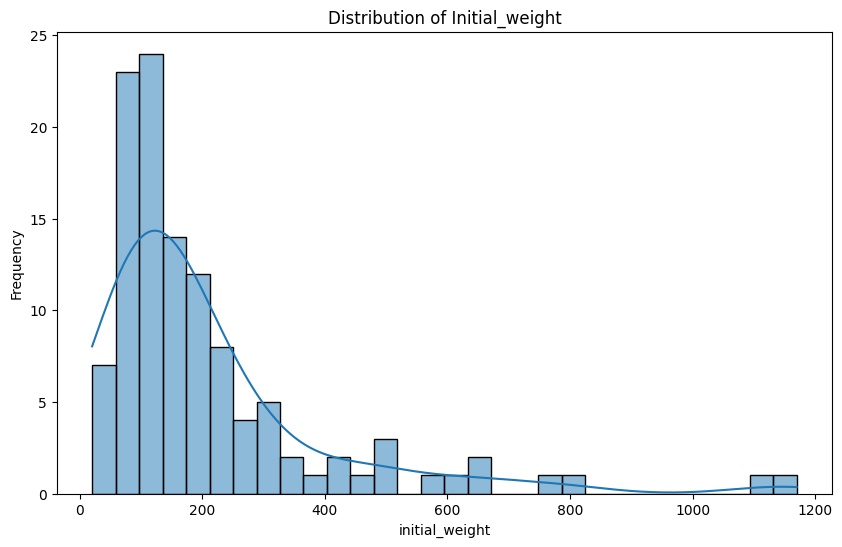

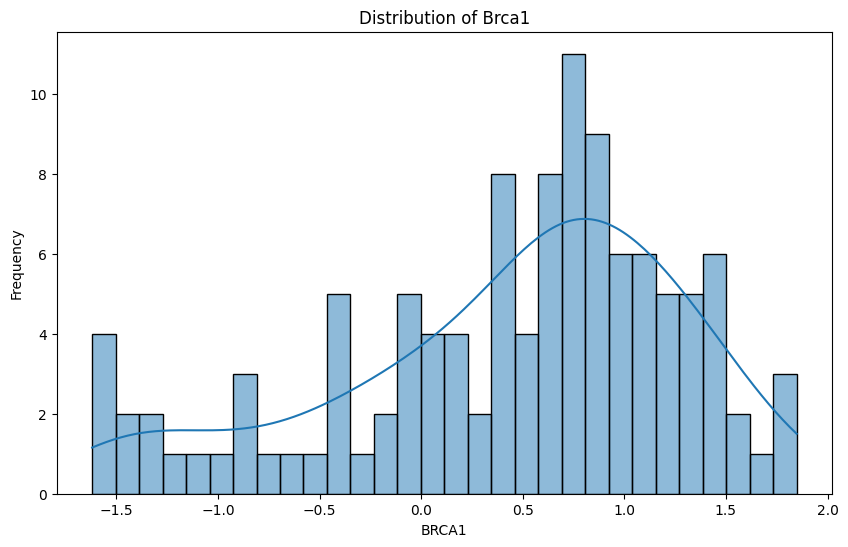

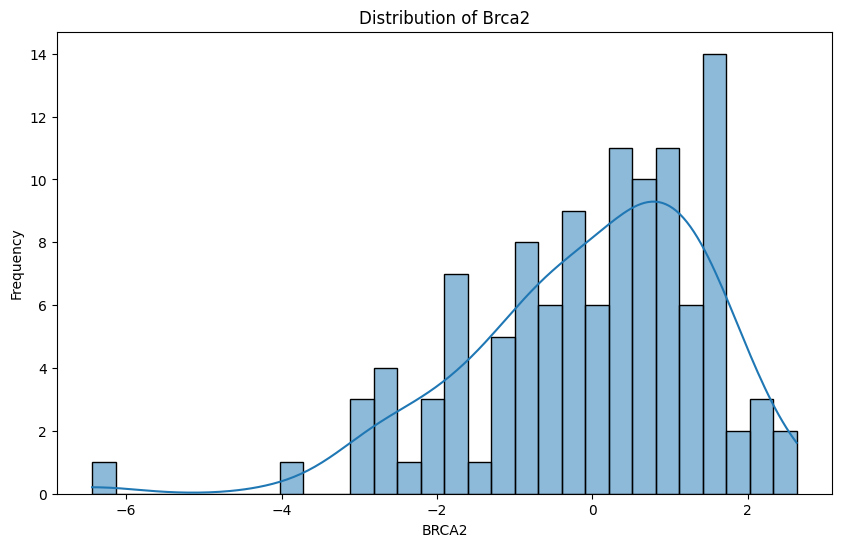

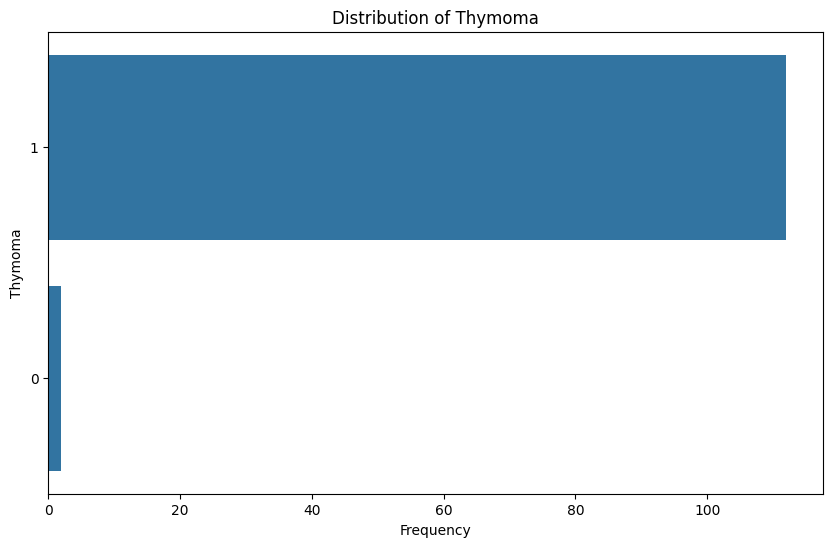

In [113]:
class DataVisualizer:
    def __init__(self, df):
        self.df = df

    def plot_distribution(self, column, numeric=True):
        plt.figure(figsize=(10, 6))
        if numeric:
            sns.histplot(self.df[column], kde=True, bins=30)
            plt.ylabel('Frequency')
        else:
            sns.countplot(y=column, data=self.df, order=self.df[column].value_counts().index)
            plt.xlabel('Frequency')
        plt.title(f'Distribution of {column.capitalize()}')
        plt.show()

    def analyze_distributions(self, numerical_columns, categorical_columns):
        for col in numerical_columns:
            self.plot_distribution(col, numeric=True)

        for col in categorical_columns:
            self.plot_distribution(col, numeric=False)

# Usage
visualizer = DataVisualizer(merged_data)

# For example, choose a few genes you are interested in for visualization:
interested_genes = [col for col in gene_list if 'brca' in col.lower()]
visualizer.analyze_distributions(numerical_columns=[condition_col, *interested_genes], 
                                 categorical_columns=[trait])

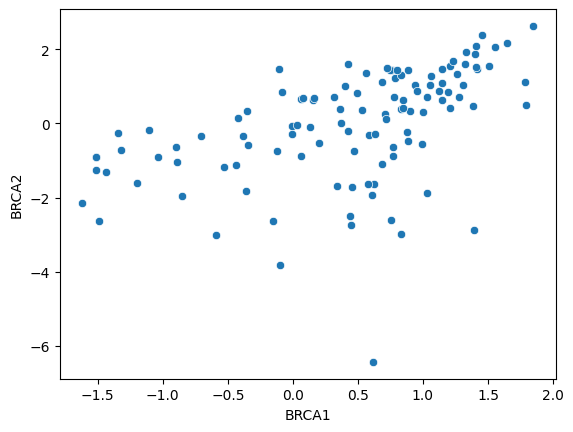

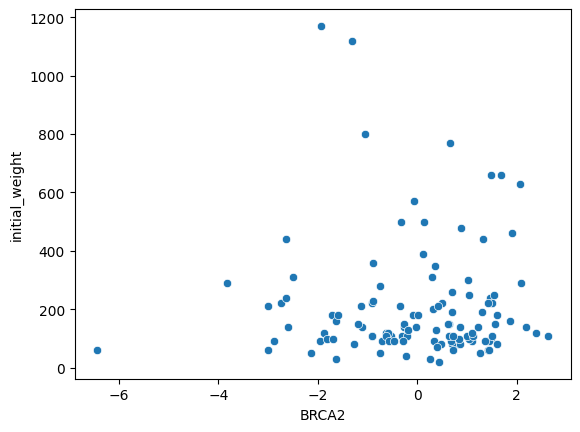

In [114]:
sns.scatterplot(data=merged_data, x='BRCA1', y='BRCA2')
plt.show()

sns.scatterplot(data=merged_data, x='BRCA2', y=condition_col)
plt.show()

### 3. Do regression & Cross Validation

In [115]:

def replace_infinity_with_nan(data):
    """Replace infinity values with NaN."""
    return np.where(np.isinf(data), np.nan, data)

def compute_normalization_params(data):
    """Compute mean and standard deviation, handling zero standard deviation."""
    mean = np.nanmean(data, axis=0)
    std = np.nanstd(data, axis=0)
    std[std <= 1e-8] = 1  # Avoid division by zero
    return mean, std

def normalize_data(data, mean, std):
    """Normalize data using given mean and standard deviation."""
    data_normalized = np.where(np.isnan(data), 0, (data - mean) / std)
    return data_normalized

def preprocess_data(X_train, X_test=None):
    X_train = replace_infinity_with_nan(X_train)
    mean_train, std_train = compute_normalization_params(X_train)

    X_train_normalized = normalize_data(X_train, mean_train, std_train)

    if X_test is not None:
        X_test = replace_infinity_with_nan(X_test)
        X_test[:, std_train <= 1] = 0  # Set zero std columns in test data to zero
        X_test_normalized = normalize_data(X_test, mean_train, std_train)
    else:
        X_test_normalized = None

    return X_train_normalized, X_test_normalized


In [120]:
def split_data(X, y, indices, train_indices, test_indices):
    """Split data into training and testing sets based on indices."""
    X_train, X_test = X[train_indices], X[test_indices]
    y_train, y_test = y[train_indices], y[test_indices]
    return X_train, X_test, y_train, y_test

def train_and_predict(X_train, y_train, X_test):
    """Train the model and make predictions."""
    var_select = VariableSelection()
    var_select.fit(X_train, y_train)
    predictions = var_select.predict(X_test)
    return predictions

def evaluate_accuracy(predictions, y_test):
    """Evaluate the accuracy of predictions."""
    binary_predictions = (predictions > 0.5).astype(int)
    return np.mean(binary_predictions == y_test)

def cross_validation(X, y, k=5):
    indices = np.arange(X.shape[0])
    np.random.shuffle(indices)

    fold_size = len(X) // k
    accuracies = []

    for i in range(k):
        test_indices = indices[i*fold_size : (i+1)*fold_size]
        train_indices = np.setdiff1d(indices, test_indices)

        X_train, X_test, y_train, y_test = split_data(X, y, indices, train_indices, test_indices)
        X_train, X_test = preprocess_data(X_train, X_test)

        predictions = train_and_predict(X_train, y_train, X_test)
        accuracy = evaluate_accuracy(predictions, y_test)
        accuracies.append(accuracy)

    return np.mean(accuracies), np.std(accuracies)

# Select relevant columns and convert to numpy array
y = merged_data[trait].values
X = merged_data.drop(columns=[trait]).values

cv_mean, cv_std = cross_validation(X, y)
print(f'The cross-validation accuracy is {(cv_mean * 100):.2f}% ± {(cv_std * 100):.2f}%')

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sparse_lmm/helpingMethods.py:49: RuntimeWarning: invalid value encountered in divide
  ts = beta / np.sqrt(var * sigma)
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sparse_lmm/VariableSelection.py:183: RuntimeWarning: divide by zero encountered in log
  return -np.log(p), np.array(betas)


The cross-validation accuracy is 1.82% ± 3.64%


In [121]:

def prepare_data(merged_data, trait):
    """Prepare and preprocess the dataset."""
    y = merged_data[trait].values
    X = merged_data.drop(columns=[trait]).values
    X, _ = preprocess_data(X)  # Assuming preprocess_data is defined elsewhere
    return X, y

def fit_model(X, y):
    """Fit the VariableSelection model to the data."""
    var_select = VariableSelection()
    var_select.fit(X, y)
    return var_select

def get_model_output(var_select):
    """Retrieve and process the model's output."""
    coefficients = var_select.getBeta().reshape(-1).tolist()
    nlog_p_values = var_select.getNegLogP().reshape(-1).tolist()
    p_values = [np.exp(-p) for p in nlog_p_values]
    return coefficients, p_values

# Main execution
X, y = prepare_data(merged_data, trait)
var_select = fit_model(X, y)
coefficients, p_values = get_model_output(var_select)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sparse_lmm/helpingMethods.py:49: RuntimeWarning: invalid value encountered in divide
  ts = beta / np.sqrt(var * sigma)


### 4. Discussion

In [118]:
import pandas as pd
from statsmodels.stats.multitest import multipletests


# Create a DataFrame for the regression results
regression_df = pd.DataFrame({
    'Variable': feature_cols,
    'Coefficient': coefficients,
    'p_value': p_values
})

# Extract information about the lifestyle condition's effect
condition_effect = regression_df.iloc[0]

# Report the effect of the lifestyle condition
print(f"Effect of the condition on the target variable:")
print(f"Variable: {condition}")
print(f"Coefficient: {condition_effect['Coefficient']:.4f}")
print(f"p-value: {condition_effect['p_value']:.4g}\n")

Effect of the condition on the target variable:
Variable: weight
Coefficient: 0.0068
p-value: 0.4677



In [119]:
threshold = 0.05
# Apply the Benjamini-Hochberg correction
rejected, corrected_p_values, _, _ = multipletests(regression_df['p_value'][1:], alpha=threshold, method='fdr_bh')

# Add the corrected p-values to the DataFrame (ignoring the first row which is the condition)
regression_df.loc[1:, 'corrected_p_value'] = corrected_p_values

# Now filter based on the corrected p-values
significant_genes = regression_df.loc[(regression_df.index > 0) & (regression_df['corrected_p_value'] < threshold)]
significant_genes_sorted = significant_genes.sort_values('corrected_p_value')

# Print and/or save your results as before
print(f"Genes with corrected p-value < {threshold}, affecting the trait {trait} conditional on the factor {condition}, sorted by corrected p-value:")
print(significant_genes_sorted[['Variable', 'Coefficient', 'corrected_p_value']].to_string(index=False))
print(f"\nFound {len(significant_genes_sorted)} significant genes with corrected p-value < {threshold}")
# Save this to a CSV file
significant_genes_sorted.to_csv('significant_genes_report_corrected.csv', index=False)

Genes with corrected p-value < 0.05, affecting the trait Thymoma conditional on the factor weight, sorted by corrected p-value:
    Variable   Coefficient  corrected_p_value
    RBMY1A3P  1.704290e-18      7.986114e-208
      P2RX6P -8.521449e-19      7.986114e-208
     TGIF2LX -2.726864e-17      7.986114e-208
       OR9G4  3.408579e-18      7.986114e-208
      OR4C16 -2.556435e-18      7.986114e-208
       OR4K5 -3.408579e-18      7.986114e-208
        TGM6 -2.726864e-17      7.986114e-208
      OR2AG1 -6.817159e-18      7.986114e-208
      OR10G7  3.408579e-18      7.986114e-208
     SNORA58 -3.408579e-18      7.986114e-208
      SNAR-H -2.130362e-19      7.986114e-208
    FLJ44082  3.408579e-18      7.986114e-208
      OR4C15 -1.704290e-18      7.986114e-208
 SNORD116-19  1.331476e-20      7.986114e-208
     SNORA35 -1.331476e-20      7.986114e-208
     DEFB110 -4.260724e-19      7.986114e-208
      KCNK18  6.817159e-18      7.986114e-208
       OR5W2  1.704290e-18      7.986114e-20